In [120]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

from importlib import reload
import hsilib as hl
hl = reload(hl)

In [2]:
def get_rayleigh_scattering(HSI):
    rayleigh_sig = np.zeros(shape = bands, dtype = HSI.dtype)
    for i in range(bands):
        layer = HSI[..., i]
        rayleigh_sig[i] = layer[layer > 0].min()
        
    return rayleigh_sig

753 1924 63


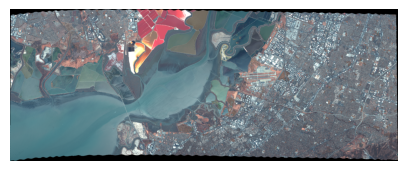

In [14]:
import spectral.io.envi as envi
hsi_path = r'C:\Users\konst\jupyter_notebook\HSI\data envil\moffet\\'
moffett_hsi = envi.open(hsi_path + r'f080611t01p00r07rdn_c_sc01_ort_img.hdr',
                        hsi_path + r'f080611t01p00r07rdn_c_sc01_ort_img')

HSI = np.array(np.rot90(moffett_hsi.open_memmap(writble = True)), dtype = np.float32)

#HSI = np.concatenate((HSI[..., :94], HSI[..., 131:]), axis = 2)
HSI = HSI[..., :63]

height, width, bands = HSI.shape

color_image = hl.HSI_to_RGB(HSI, (37, 18, 11))
print(height, width, bands)
hl.show(color_image, figsize = (5, 5))

In [15]:
rayleigh_scattering = get_rayleigh_scattering(HSI)
HSI -= rayleigh_scattering
HSI[HSI < 0] = 0
bl = np.all(HSI == 0, axis = 2)
HSI[bl] = -50

In [16]:
reference_coords = np.array(((540,  470),  #0  water
                             (288,  758),  #1  dirt
                             (154,  834),  #2  swamps
                             (315, 1334),  #3  soil
                             (335, 1360),  #4  vegetable
                             (305, 1280),  #5  concrete
                             (278,  606),  #6  salt
                             (18,   811),  #7  salt_water
                             (365, 1431),  #8  asphalt
                             (183, 1208),  #9  lake
                             (707, 1810),  #10 clay
                             (241, 1299),  #11 roof
                             (427, 774),   #12 water2
                             (59, 1098),   #13 lake 2
                             (142, 704),   #14 salt 2
                             (93, 1137)),  #15 swamps 2
                             dtype = int)

name_reference =    ("water", "dirt",        "swamps", "soil",  "vegetable",      "concrete", "salt", "salt_water",   "asphalt", "lakes", "clay",  "roofs", "deep water",    "lakes 2", "salt 2", 'swamps 2')
name_reference_ru = ("вода",  "загрязнения", "болота", "почва", "растительность", "бетон",    "соль", "солёная вода", "асфальт", "озёра", "глина", "крыши", "мелководье", "озёра 2", "соль 2", 'болота 2')

colors_class = np.array(((0.16, 0.56, 0.56), (0.64, 0.28, 0.64), (0.05, 0.54, 0.13),
                         (0.72, 0.45, 0.2), (0, 0.9, 0), (0.75, 0.75, 0.75),
                         #(1, 1, 0), (1, 0, 0), (0.1, 0.1, 1),
                         #(0.3, 0.3, 0.3), (1, 0.46, 0.22), (0.95, 0.95, 1),
                         (1, 1, 0), (1, 0, 0), (0.3, 0.3, 0.3),
                         (0.6, 0.35, 0.35), (1, 0.46, 0.22), (0.95, 0.95, 1),
                         (0.26, 0.70, 0.70), (0.2, 0.2, 0.4), (0.4, 0.1, 0.1),
                         (0.2, 0.4, 0.2)))

In [17]:
hsi_reference = hl.calc_ref(reference_coords, HSI, 1)

In [18]:
imf_reference = hl.EMD(hsi_reference, 4)

обработано 16 пикселей из 16

In [19]:
def EVKLID(vector1, vector2):
    return np.linalg.norm(vector1 - vector2)

def ANGLE(vector1, vector2):
    unit_vector1 = vector1 / np.linalg.norm(vector1)
    unit_vector2 = vector2 / np.linalg.norm(vector2)

    return np.dot(unit_vector1, unit_vector2)

def SID(s1, s2):    
    s1 = s1 - s1.min() + 1
    s2 = s2 - s2.min() + 1
    
    p = s1 / np.sum(s1)
    q = s2 / np.sum(s2)
    return np.sum((p - q) * (np.log(p) - np.log(q)))

In [20]:
def evklid_seg(image, reference, bl = None):
    evklid_dist =  np.zeros(shape=(16, height, width), dtype = float)

    for r in range(16):
        for i in range(height):
            for j in range(width):
            
                evklid_dist[r, i, j] = EVKLID(image[i, j], reference[r])
            
        print('\r', end = '')
        print(r + 1, end = '')
        
        
    evklid_label = evklid_dist.argmin(axis = 0)
    evklid_color = np.zeros(shape = (height, width, 3), dtype = np.uint8)
    
    for i in range(colors_class.shape[0]):
        evklid_color[evklid_label == i] = np.uint8(colors_class[i] * 255)
    
    if bl is not None:
        evklid_color[bl] = (0, 0, 0)
        
    plt.figure(figsize = (25, 15))
    plt.imshow(evklid_color)
    plt.axis("off")
    plt.show()
    
    return evklid_dist, evklid_label, evklid_color

In [21]:
def angle_seg(image, reference, bl = None):
    angle_dist =  np.zeros(shape=(16, height, width), dtype = float)

    for r in range(16):
        for i in range(height):
            for j in range(width):
            
                angle_dist[r, i, j] = ANGLE(image[i, j], reference[r])
            
        print('\r', end = '')
        print(r + 1, end = '')
        
    angle_label = angle_dist.argmax(axis = 0)
    angle_color = np.zeros(shape = (height, width, 3), dtype = np.uint8)
    
    for i in range(colors_class.shape[0]):
        angle_color[angle_label == i] = np.uint8(colors_class[i] * 255)
    
    if bl is not None:
        angle_color[bl] = (0, 0, 0)
    
    plt.figure(figsize = (25, 15))
    plt.imshow(angle_color)
    plt.axis("off")
    plt.show()
    
    return angle_dist, angle_label, angle_color

In [22]:
def sid_seg(image, reference, bl = None):
    sid_dist =  np.zeros(shape=(16, height, width), dtype = float)

    for r in range(16):
        for i in range(height):
            for j in range(width):
            
                sid_dist[r, i, j] = SID(image[i, j], reference[r])
            
        print('\r', end = '')
        print(r + 1, end = '')
        
    sid_label = sid_dist.argmin(axis = 0)
    sid_color = np.zeros(shape = (height, width, 3), dtype = np.uint8)
    
    for i in range(colors_class.shape[0]):
        sid_color[sid_label == i] = np.uint8(colors_class[i] * 255)
        
    sid_color[bl] = (0, 0, 0)
    
    plt.figure(figsize = (25, 15))
    plt.imshow(sid_color)
    plt.axis("off")
    plt.show()

16

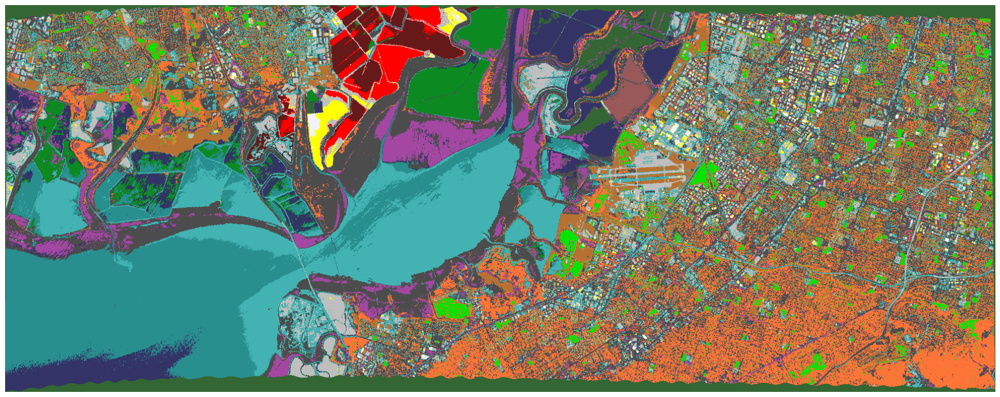

In [23]:
evklid_dist, evklid_label, evklid_color = evklid_seg(HSI, hsi_reference, bl)

16

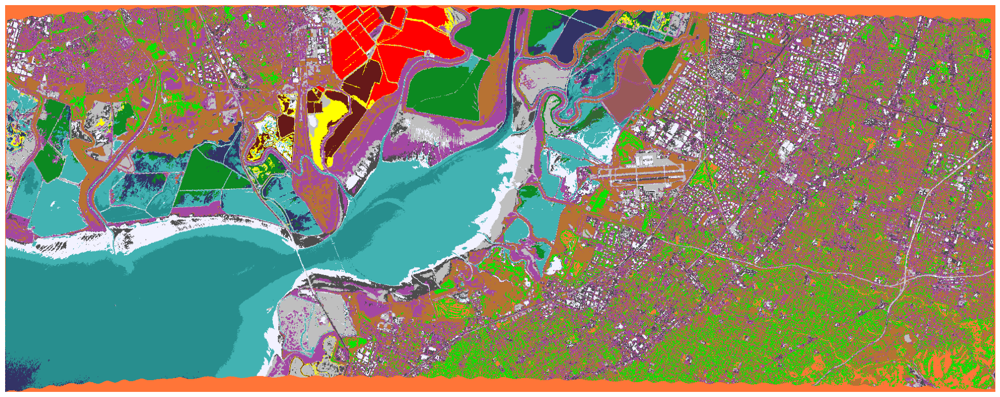

In [24]:
angle_dist, angle_label, angle_color = angle_seg(HSI, hsi_reference, bl)

# imf #3 + source

In [25]:
imfs = hl.EMD(HSI, 4)

обработано 1447601 пикселей из 1448772

In [26]:
num_imf = 2

norm_hsi_reference = np.zeros(shape = hsi_reference.shape, dtype = float)
norms = np.linalg.norm(imf_reference[num_imf], axis = 1) / np.linalg.norm(hsi_reference, axis = 1)

for i in range(len(reference_coords)):
    norm_hsi_reference[i] = hsi_reference[i] * norms[i]

compose_reference = np.concatenate((imf_reference[num_imf], norm_hsi_reference), axis = 1)
compose_reference.shape

(16, 126)

In [27]:
n_imf = 2

imf = imfs[n_imf]

norm_hsi = np.linalg.norm(HSI, axis = 2)
norm_imf = np.linalg.norm(imf, axis = 2)

imf_con_source = np.zeros(shape = (height, width, bands * 2))

for h in range(height):
    for w in range(width):

        imf_con_source[h, w, :bands] = imf[h, w]
        imf_con_source[h, w, bands:] = HSI[h, w] * (norm_imf[h, w] / norm_hsi[h, w])
        
    if h % 100 == 0:
        print('\r', end = '')
        print(h, end = '')
        
imf_con_source = np.nan_to_num(imf_con_source, 0)
imf_con_source[bl] = -50

700

16

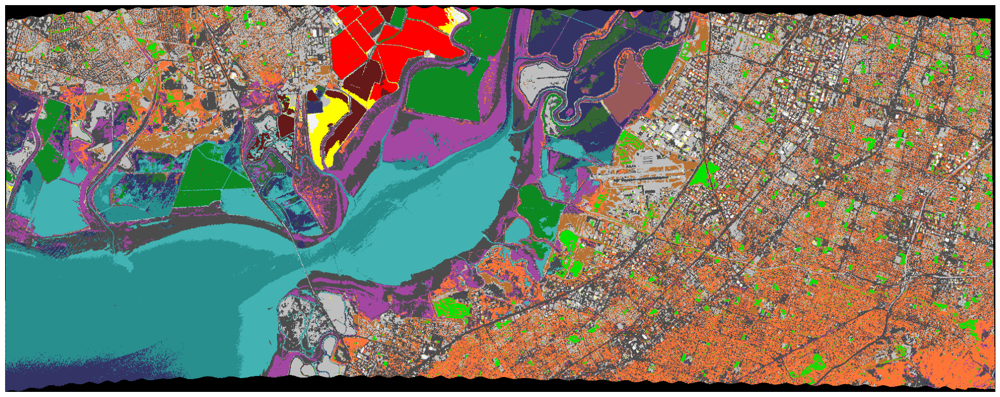

(array([[[599.06882703, 599.06882703, 599.06882703, ..., 599.06882703,
          599.06882703, 599.06882703],
         [599.06882703, 599.06882703, 599.06882703, ..., 599.06882703,
          599.06882703, 599.06882703],
         [599.06882703, 599.06882703, 599.06882703, ..., 599.06882703,
          599.06882703, 599.06882703],
         ...,
         [ 28.01381436,  21.73555299,  25.73826873, ..., 599.06882703,
          599.06882703, 599.06882703],
         [ 24.66027928,  23.93206992, 599.06882703, ..., 599.06882703,
          599.06882703, 599.06882703],
         [ 23.58001528,  27.66786296,  24.6523897 , ..., 599.06882703,
          599.06882703, 599.06882703]],
 
        [[602.112875  , 602.112875  , 602.112875  , ..., 602.112875  ,
          602.112875  , 602.112875  ],
         [602.112875  , 602.112875  , 602.112875  , ..., 602.112875  ,
          602.112875  , 602.112875  ],
         [602.112875  , 602.112875  , 602.112875  , ..., 602.112875  ,
          602.112875  , 602.1128

In [28]:
evklid_seg(imf_con_source, compose_reference, bl)

16

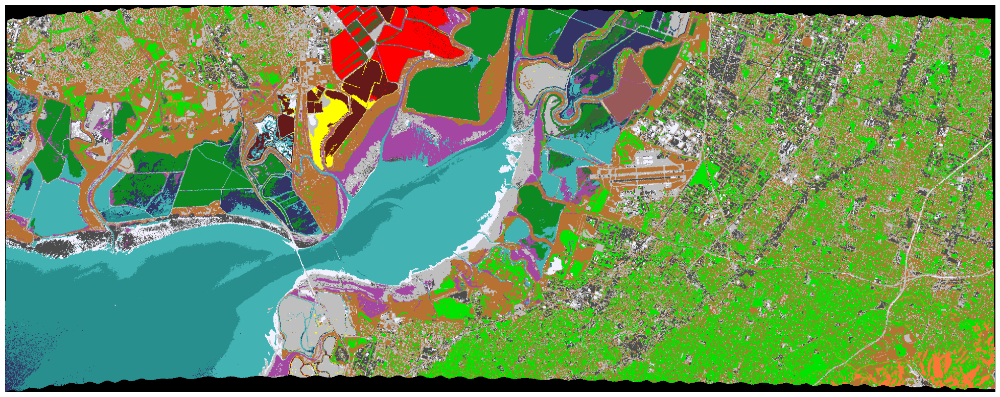

(array([[[-0.4583899 , -0.4583899 , -0.4583899 , ..., -0.4583899 ,
          -0.4583899 , -0.4583899 ],
         [-0.4583899 , -0.4583899 , -0.4583899 , ..., -0.4583899 ,
          -0.4583899 , -0.4583899 ],
         [-0.4583899 , -0.4583899 , -0.4583899 , ..., -0.4583899 ,
          -0.4583899 , -0.4583899 ],
         ...,
         [ 0.97123432,  0.98330454,  0.97830341, ..., -0.4583899 ,
          -0.4583899 , -0.4583899 ],
         [ 0.97894716,  0.98140906, -0.4583899 , ..., -0.4583899 ,
          -0.4583899 , -0.4583899 ],
         [ 0.98076489,  0.96958908,  0.979651  , ..., -0.4583899 ,
          -0.4583899 , -0.4583899 ]],
 
        [[-0.47960007, -0.47960007, -0.47960007, ..., -0.47960007,
          -0.47960007, -0.47960007],
         [-0.47960007, -0.47960007, -0.47960007, ..., -0.47960007,
          -0.47960007, -0.47960007],
         [-0.47960007, -0.47960007, -0.47960007, ..., -0.47960007,
          -0.47960007, -0.47960007],
         ...,
         [ 0.73079697,  0.7629129

In [29]:
angle_seg(imf_con_source, compose_reference, bl)

# imf #1 + imf #4

In [30]:
norm_3_imf = np.zeros(shape = imf_reference[2].shape, dtype = float)

norms = np.linalg.norm(imf_reference[0], axis = 1) / np.linalg.norm(imf_reference[3], axis = 1)

for i in range(len(name_reference)):
    norm_3_imf[i] = imf_reference[3, i] * norms[i]

compose_reference = np.concatenate((imf_reference[0], norm_3_imf), axis = 1)
compose_reference.shape

(16, 126)

In [31]:
imf1 = imfs[0]
imf3 = imfs[3]


norm_imf1 = np.linalg.norm(imf1, axis = 2)
norm_imf3 = np.linalg.norm(imf3, axis = 2)

imf_con_imf = np.zeros(shape = (height, width, bands * 2))

for h in range(height):
    for w in range(width):

        imf_con_imf[h, w, :bands] = imf1[h, w]
        imf_con_imf[h, w, bands:] = imf3[h, w] * (norm_imf1[h, w] / norm_imf3[h, w])
        
    if h % 100 == 0:
        print('\r', end = '')
        print(h, end = '')
        
imf_con_imf = np.nan_to_num(imf_con_imf, 0)

bool_mask = np.all(imf_con_imf == 0, axis = 2)
imf_con_imf[bool_mask] = -50

C:\Users\konst\AppData\Local\Temp\ipykernel_7792\3876177113.py:14: RuntimeWarning: invalid value encountered in scalar divide
  imf_con_imf[h, w, bands:] = imf3[h, w] * (norm_imf1[h, w] / norm_imf3[h, w])


700

16

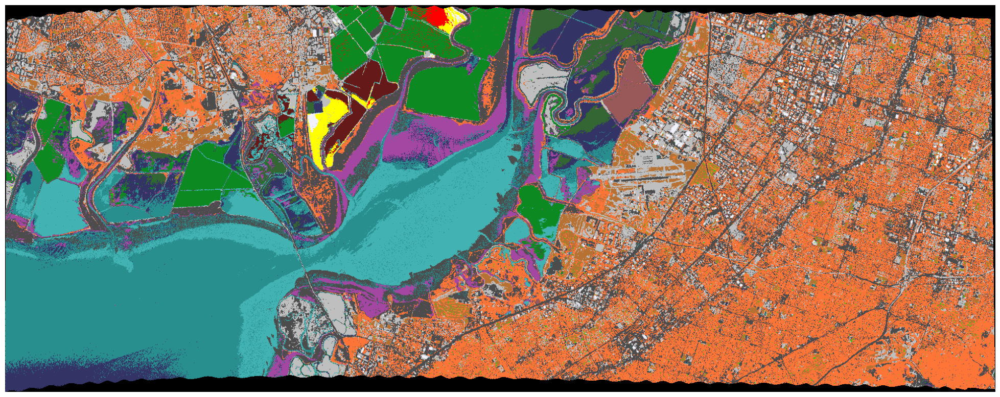

(array([[[669.41068355, 669.41068355, 669.41068355, ..., 669.41068355,
          669.41068355, 669.41068355],
         [669.41068355, 669.41068355, 669.41068355, ..., 669.41068355,
          669.41068355, 669.41068355],
         [669.41068355, 669.41068355, 669.41068355, ..., 669.41068355,
          669.41068355, 669.41068355],
         ...,
         [162.95083536, 128.26133111, 156.82799322, ..., 669.41068355,
          669.41068355, 669.41068355],
         [144.71742602, 135.14360217, 669.41068355, ..., 669.41068355,
          669.41068355, 669.41068355],
         [143.88629441, 164.30152405, 151.6079878 , ..., 669.41068355,
          669.41068355, 669.41068355]],
 
        [[701.3200342 , 701.3200342 , 701.3200342 , ..., 701.3200342 ,
          701.3200342 , 701.3200342 ],
         [701.3200342 , 701.3200342 , 701.3200342 , ..., 701.3200342 ,
          701.3200342 , 701.3200342 ],
         [701.3200342 , 701.3200342 , 701.3200342 , ..., 701.3200342 ,
          701.3200342 , 701.3200

In [32]:
evklid_seg(imf_con_imf, compose_reference, bl)

16

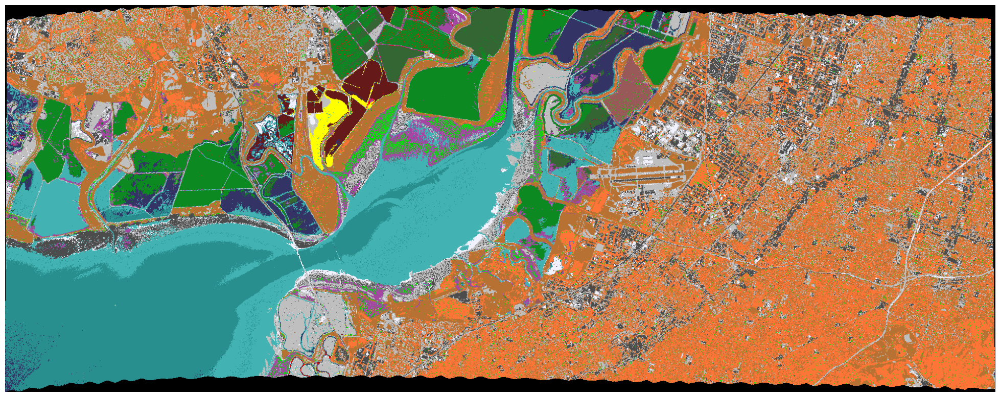

(array([[[-1.25176673e-09, -1.25176673e-09, -1.25176673e-09, ...,
          -1.25176673e-09, -1.25176673e-09, -1.25176673e-09],
         [-1.25176673e-09, -1.25176673e-09, -1.25176673e-09, ...,
          -1.25176673e-09, -1.25176673e-09, -1.25176673e-09],
         [-1.25176673e-09, -1.25176673e-09, -1.25176673e-09, ...,
          -1.25176673e-09, -1.25176673e-09, -1.25176673e-09],
         ...,
         [ 9.50909732e-01,  9.68464947e-01,  9.64252878e-01, ...,
          -1.25176673e-09, -1.25176673e-09, -1.25176673e-09],
         [ 9.54728661e-01,  9.72907187e-01, -1.25176673e-09, ...,
          -1.25176673e-09, -1.25176673e-09, -1.25176673e-09],
         [ 9.63895307e-01,  9.59432568e-01,  9.65499672e-01, ...,
          -1.25176673e-09, -1.25176673e-09, -1.25176673e-09]],
 
        [[-7.68210304e-03, -7.68210304e-03, -7.68210304e-03, ...,
          -7.68210304e-03, -7.68210304e-03, -7.68210304e-03],
         [-7.68210304e-03, -7.68210304e-03, -7.68210304e-03, ...,
          -7.68210304

In [33]:
angle_seg(imf_con_imf, compose_reference, bl)

16

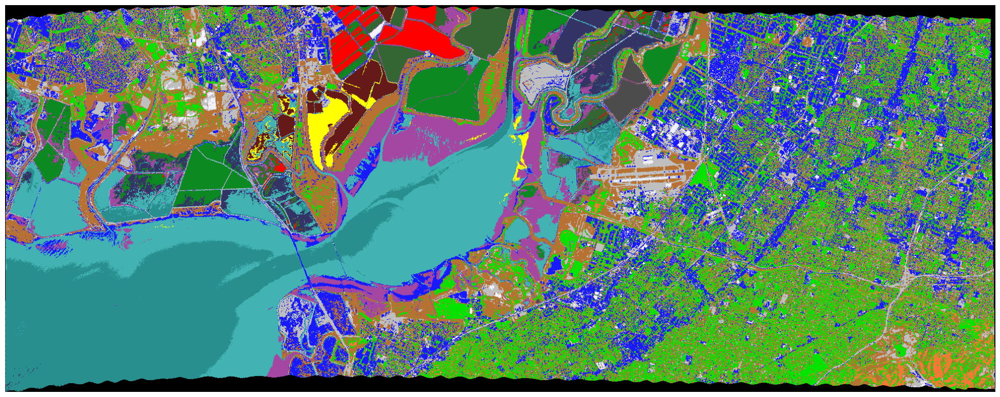

In [71]:
sid_seg(imf_con_imf, compose_reference, bl)

# imf #1 + imf #4 + lf

In [20]:
s1 = imf_reference[0].copy()
s2 = imf_reference[3].copy()
s3 = hsi_reference - np.sum(imf_reference, axis = 0)

norm_s2 = np.zeros(shape = s2.shape, dtype = float)
norm_s3 = np.zeros(shape = s3.shape, dtype = float)

norm_value_s2 = np.linalg.norm(s1, axis = 1) / np.linalg.norm(s2, axis = 1)
norm_value_s3 = np.linalg.norm(s1, axis = 1) / np.linalg.norm(s3, axis = 1)

for i in range(s1.shape[0]):
    norm_s2[i] = s2[i] * norm_value_s2[i]
    norm_s3[i] = s3[i] * norm_value_s3[i]

compose_reference = np.concatenate((s1, norm_s2, norm_s3), axis = 1)
#compose_reference = np.sum((s1, norm_s2, norm_s3), axis = 0) #for sum
compose_reference.shape

(16, 561)

In [21]:
s1 = imfs[0]
s2 = imfs[3]
s3 = HSI - np.sum(imfs, axis = 0)


norm_s1 = np.linalg.norm(s1, axis = 2)
norm_s2 = np.linalg.norm(s2, axis = 2)
norm_s3 = np.linalg.norm(s3, axis = 2)

imf_con_imf_con_imf = np.zeros(shape = (height, width, bands * 3))
#imf_con_imf_con_imf = np.zeros(shape = (height, width, bands)) # for sum

for h in range(height):
    for w in range(width):
        
        imf_con_imf_con_imf[h, w, bands*0:bands*1] = s1[h, w]
        imf_con_imf_con_imf[h, w, bands*1:bands*2] = s2[h, w] * (norm_s1[h, w] / norm_s2[h, w])
        imf_con_imf_con_imf[h, w, bands*2:bands*3] = s3[h, w] * (norm_s1[h, w] / norm_s3[h, w])
        #imf_con_imf_con_imf[h, w] = np.sum((s1[h, w],
        #                                    s2[h, w] * (norm_s1[h, w] / norm_s2[h, w]),
        #                                    s3[h, w] * (norm_s1[h, w] / norm_s3[h, w])), axis = 0)
        
    if h % 100 == 0:
        print('\r', end = '')
        print(h, end = '')
        
imf_con_imf_con_imf = np.nan_to_num(imf_con_imf_con_imf, 0)

imf_con_imf_con_imf[bl] = -50

C:\Users\konst\AppData\Local\Temp\ipykernel_16724\1322691869.py:17: RuntimeWarning: invalid value encountered in scalar divide
  imf_con_imf_con_imf[h, w, bands*1:bands*2] = s2[h, w] * (norm_s1[h, w] / norm_s2[h, w])


700

16

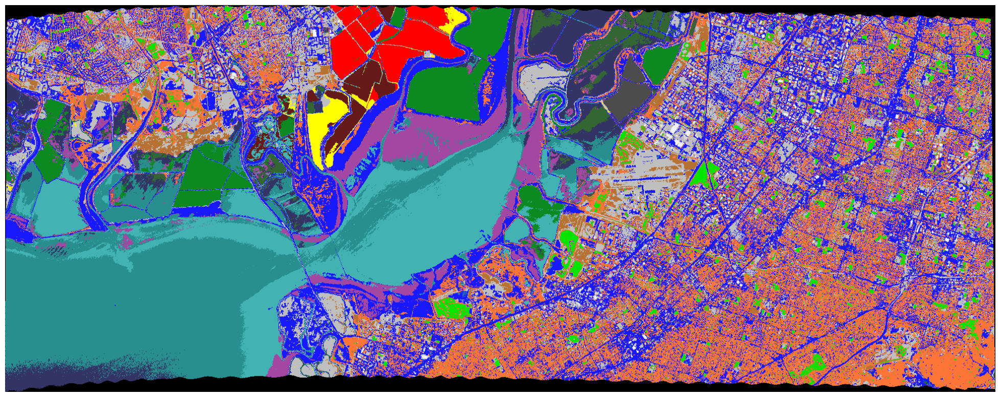

In [88]:
evklid_dist, evklid_label, evklid_color = evklid_seg(imf_con_imf_con_imf, compose_reference, bl)

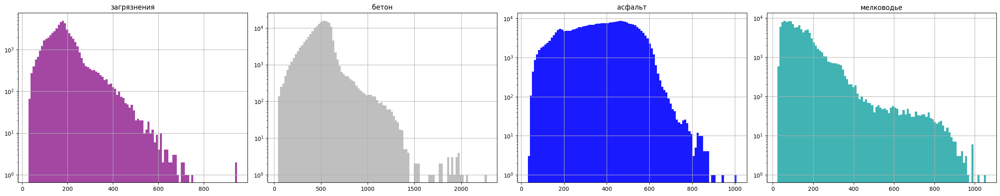

In [91]:
angle_label[bl == True] = -1
plt.figure(figsize = (25, 5))
for p, i in enumerate((1, 5, 8, 12)):
    hsit_dist = evklid_dist[i, evklid_label == i]
    plt.subplot(141 + p)
    plt.title(name_reference_ru[i])
    plt.hist(hsit_dist.flatten(), bins = 100, color = colors_class[i], log = True)
    plt.grid()
plt.tight_layout()
plt.show()

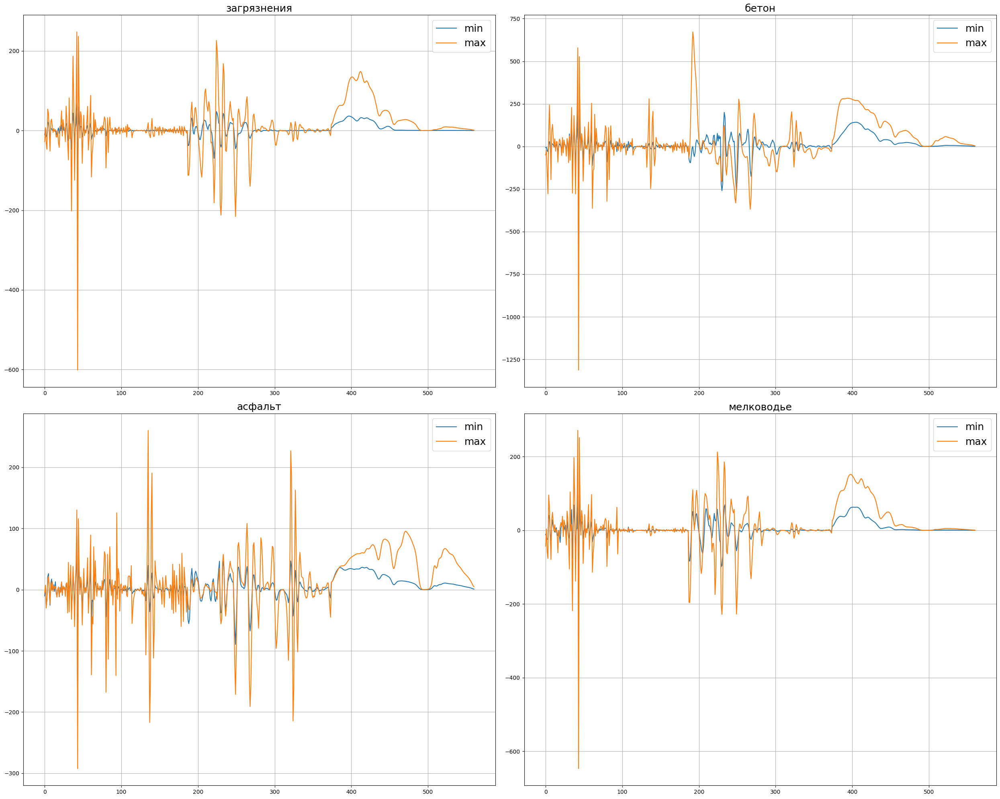

In [92]:
plt.figure(figsize = (25, 20))
for p, i in enumerate((1, 5, 8, 12)):
    max_sig = np.argmax( np.mean(imf_con_imf_con_imf[evklid_label == i], axis = 1) )
    min_sig = np.argmin( np.mean(imf_con_imf_con_imf[evklid_label == i], axis = 1) )
    mean_sig = np.mean(imf_con_imf_con_imf[evklid_label == i], axis = 0)
    
    plt.subplot(221 + p)
    plt.title(name_reference_ru[i], fontsize = 18)
    plt.plot(imf_con_imf_con_imf[evklid_label == i][min_sig], label = 'min')
    plt.plot(imf_con_imf_con_imf[evklid_label == i][max_sig], label = 'max')
    #plt.ylim(-50, 50)
    #plt.plot(mean_sig)
    plt.legend(fontsize = 18)
    plt.grid()
plt.tight_layout()
plt.show()

In [95]:
HSI.shape

(753, 1924, 187)

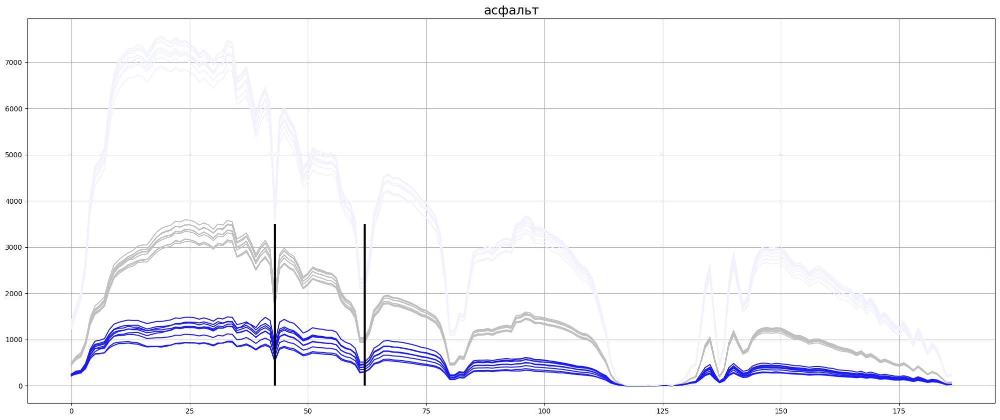

In [119]:
plt.figure(figsize = (25, 10))
plt.title(name_reference_ru[8], fontsize = 18)

#for c in (1, 5, 8, 12,4 ,10):
for c in (5, 8,11):
    for i in range(-1, 2):
        for j in range(-1, 2):

            plt.plot(HSI[reference_coords[c, 0] + i, reference_coords[c, 1] + j], color = colors_class[c])
        
#plt.legend(fontsize = 18)
plt.vlines(62, 0, 3500, lw = 3, color = 'black')
plt.vlines(43, 0, 3500, lw = 3, color = 'black')
plt.grid()
plt.show()

16

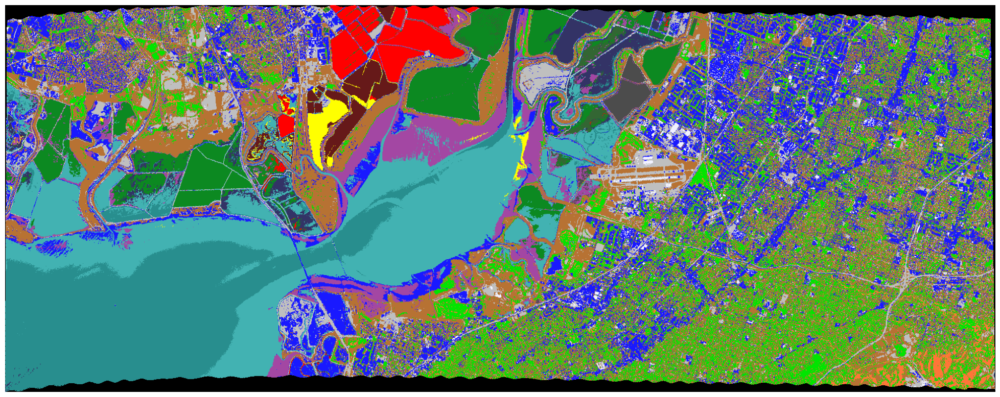

In [26]:
angle_dist, angle_label, angle_color = angle_seg(imf_con_imf_con_imf, compose_reference, bl)

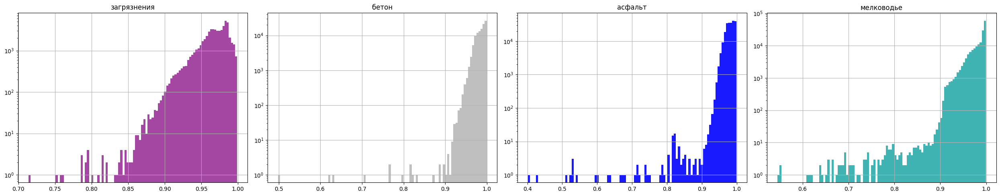

In [54]:
angle_label[bl == True] = -1
plt.figure(figsize = (25, 5))
for p, i in enumerate((1, 5, 8, 12)):
    hsit_dist = angle_dist[i, angle_label == i]
    plt.subplot(141 + p)
    plt.title(name_reference_ru[i])
    plt.hist(hsit_dist.flatten(), bins = 100, color=colors_class[i], log = True)
    plt.grid()
plt.tight_layout()
plt.show()

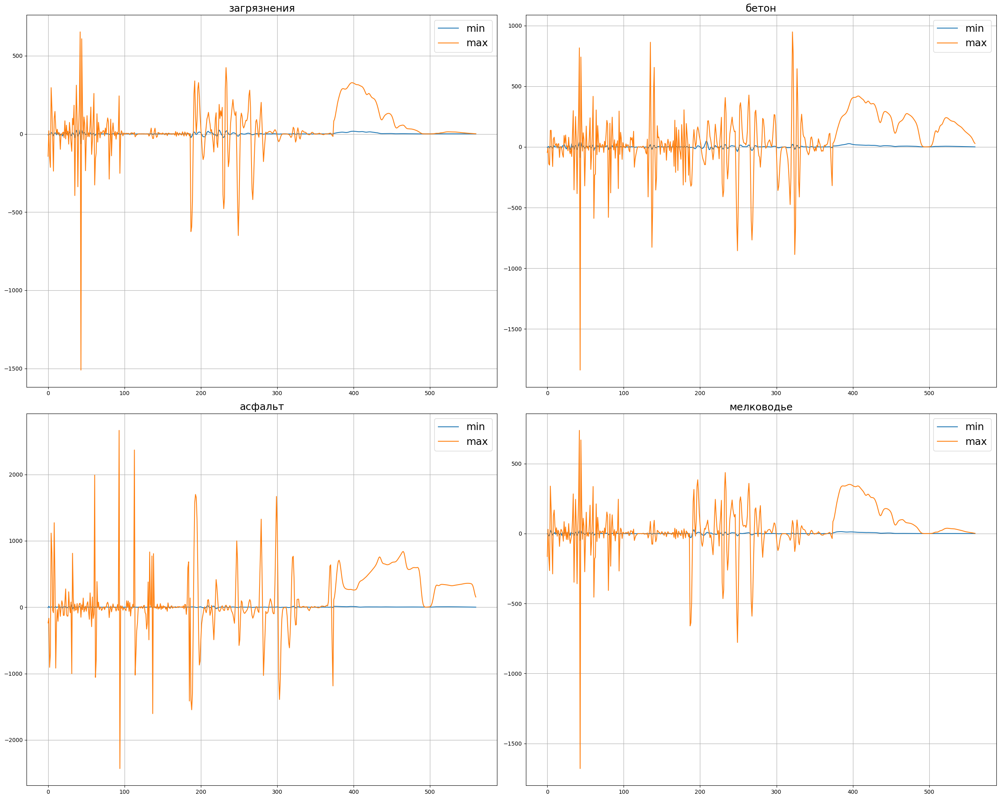

In [85]:
plt.figure(figsize = (25, 20))
for p, i in enumerate((1, 5, 8, 12)):
    max_sig = np.argmax( np.mean(imf_con_imf_con_imf[angle_label == i], axis = 1) )
    min_sig = np.argmin( np.mean(imf_con_imf_con_imf[angle_label == i], axis = 1) )
    mean_sig = np.mean(imf_con_imf_con_imf[angle_label == i], axis = 0)
    
    plt.subplot(221 + p)
    plt.title(name_reference_ru[i], fontsize = 18)
    plt.plot(imf_con_imf_con_imf[angle_label == i][min_sig], label = 'min')
    plt.plot(imf_con_imf_con_imf[angle_label == i][max_sig], label = 'max')
    #plt.ylim(-50, 50)
    #plt.plot(mean_sig)
    plt.legend(fontsize = 18)
    plt.grid()
plt.tight_layout()
plt.show()

# mahalanobis + PCA

In [56]:
from sklearn.decomposition import PCA
from scipy.spatial.distance import mahalanobis

In [57]:
clear_hsi = HSI[bl == False]
pca = PCA(n_components = bands).fit(clear_hsi)

In [58]:
V = pca.components_

In [59]:
def mahalanobis_seg(image, reference, V, bl = None):
    
    mahalanobis_dist =  np.zeros(shape=(16, height, width), dtype = float)

    for r in range(16):
        for i in range(height):
            for j in range(width):
            
                mahalanobis_dist[r, i, j] = mahalanobis(image[i, j], reference[r], V)
            
        print('\r', end = '')
        print(r + 1, end = '')
    
    mahalanobis_dist = np.nan_to_num(mahalanobis_dist, 0)
    
    mahalanobis_label = mahalanobis_dist.argmin(axis = 0)
    mahalanobis_color = np.zeros(shape = (height, width, 3), dtype = np.uint8)
    
    for i in range(colors_class.shape[0]):
        mahalanobis_color[mahalanobis_label == i] = np.uint8(colors_class[i] * 255)
        
    mahalanobis_color[bl] = (0, 0, 0)
    
    plt.figure(figsize = (25, 15))
    plt.imshow(mahalanobis_color)
    plt.axis("off")
    plt.show()
    
    return mahalanobis_dist, mahalanobis_label, mahalanobis_color

In [60]:
mahalanobis_dist, mahalanobis_label, mahalanobis_color = mahalanobis_seg(HSI, hsi_reference, V)

C:\Users\konst\miniconda3\lib\site-packages\scipy\spatial\distance.py:1023: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(m)


1

KeyboardInterrupt: 

In [51]:
mahalanobis_dist = np.nan_to_num(mahalanobis_dist, 0)

In [52]:
mahalanobis_label = mahalanobis_dist.argmin(axis = 0)

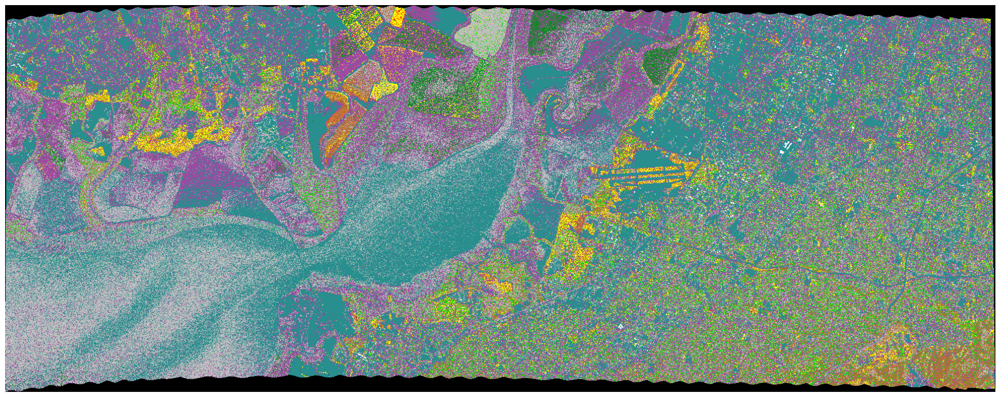

In [53]:
mahalanobis_color = np.zeros(shape = (height, width, 3), dtype = np.uint8)
    
for i in range(colors_class.shape[0]):
    mahalanobis_color[mahalanobis_label == i] = np.uint8(colors_class[i] * 255)
        
mahalanobis_color[bl] = (0, 0, 0)
    
plt.figure(figsize = (25, 15))
plt.imshow(mahalanobis_color)
plt.axis("off")
plt.show()

In [9]:
imfs = hl.EMD(HSI, 4)

обработано 1447601 пикселей из 1448772

In [48]:
clear_data = imf_con_imf[bl == False]
pca = PCA(n_components = imf_con_imf.shape[2]).fit(clear_data)
V = pca.components_

C:\Users\konst\miniconda3\lib\site-packages\scipy\spatial\distance.py:1023: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(m)


16

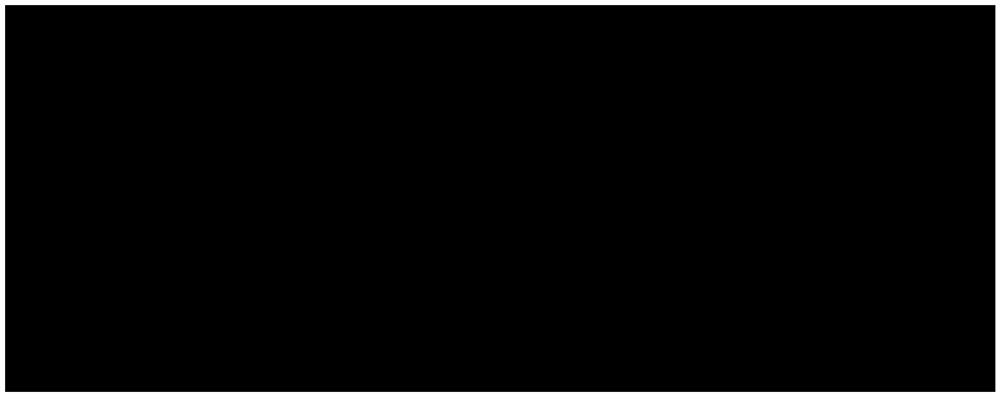

In [50]:
mahalanobis_dist, mahalanobis_label, mahalanobis_color = mahalanobis_seg(imf_con_imf, compose_reference, V)